# Algotytm przecinania się odcinków na płaszczyźnie

In [253]:

import sortedcontainers as sc
import random
import numpy as np
import pandas as pd
from bitalg.tests.test4 import Test
from bitalg.visualizer.main import Visualizer

# Przydatne funkcje 

In [254]:
def draw_example_1():
    # TODO narysowac to uzywając naszego narzędzia do wizualizacji
    vis = Visualizer()
    line_segments = ((-0.5, 0.5), (8.5, 3.5),
                     (1, 3), (7, 5),
                     (2, 4), (5, 1),
                     (4.5, 3), (6.5, 6),
                     (0, 5), (5.5, 5.5))

    vis.add_line_segment(line_segments)
    vis.show()
    
def draw_example_2():
    # TODO narysowac to uzywając naszego narzędzia do wizualizacji
    vis = Visualizer()
    line_segments = ((-0.5, 0.5), (8.5, 3.5),
                     (1, 3), (7, 5),
                     (2, 4), (5, 1),
                     (4.5, 3), (6.5, 6),
                     (0, 5), (5.5, 5.5))
    points = [(4, 2),
              (2.5, 3.5),
              (5.5, 4.5)]

    vis.add_line_segment(line_segments)
    vis.add_point(points, color='red')
    vis.show()


### Wprowadzenie
Celem ćwiczenia jest implementacja i zapoznanie się z algorytmem wyznaczającym wszystkie przecięcia się odcinków na płaszczyźnie

### Przykładowy zbiór odcinków przed wyznaczeniem punktów przecięcia

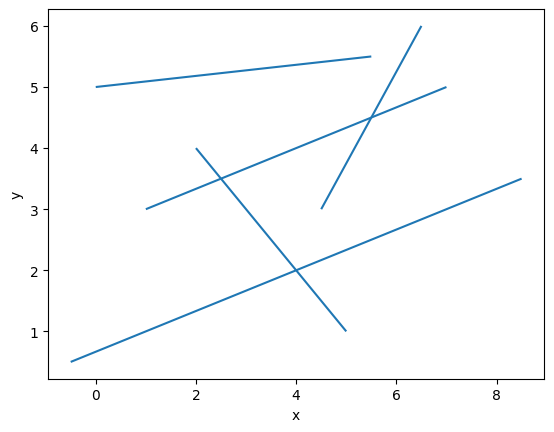

In [255]:
draw_example_1()

### Przykładowy zbiór odcinków po wyznaczenu punktów przecięcia

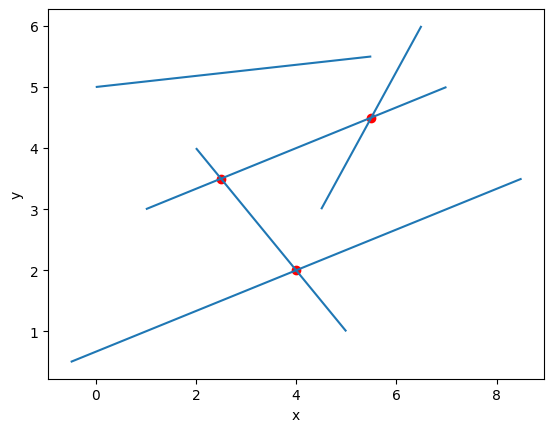

In [256]:
draw_example_2()

# Generowanie losowych odcinków na płaszczyźnie

Uzupełnij funkcję ```generate_uniform_sections```

In [257]:
def generate_uniform_sections(max_x, max_y, n):
    t=[]
    x=[]
    for i in range (n):
        x1=random.uniform(0,max_x)
        while x1 in x:
            x1=random.uniform(0,max_x)
        x.append(x1)
        x2=random.uniform(0,max_x)
        while x2 in x:
            x2=random.uniform(0,max_x)
        x.append(x2)
        y1=random.uniform(0,max_y)
        y2=random.uniform(0,max_y)
        t.append(((x1,y1),(x2,y2)))
        """
    Funkcja generuje odcinki o współrzędnych rzeczywistych w postaci par punktów. 
    Żaden wygenerowany odcinek nie jest odcinkiem pionowym.
    Żadne dwa odcinki nie mają swoich końców o takiej samej współrzędnej x.
    Zakres współrzędnych: x -> (0, max_x), y -> (0, max_y)
    :param max_x: określa maksymalną wartość współrzednej x jaka może zostać wylosowana
    :param max_y: określa maksymalną wartość współrzednej y jaka może zostać wylosowana
    :param n: ilość generowanych odcinków
    :return: tablica odcinków w postaci krotek zawierających parę krotek współrzędnych punktów końcowych odcinków
    np. [((x1, y1), (x2, y2)), ((x3, y3), (x4, y4)),...]
    """
        

    return t

In [258]:
Test().runtest(1, generate_uniform_sections)

Lab 4, task 1:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 1.295s


<span style="color:red">Ćw.</span> Wygeneruj $\large20$ losowych odcinków w przestrzeni 2D o współrzędnych z przedziału $\large x \in \langle 0,1000 \rangle$ oraz $\large y \in \langle 0,1000\rangle$. 

In [297]:
section = generate_uniform_sections(1000, 1000, 20)

Zwizualizuj otrzymane odcinki

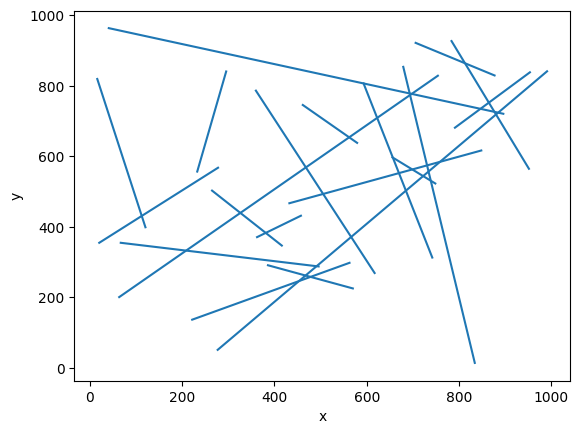

In [298]:
vis=Visualizer()
vis.add_line_segment(section)
vis.show()

Uzupełnij funkcję ```add_sections``` #interaktywne dodawanie odcinków przez rysowanie myszką (jak?) TODO

In [261]:
# def add_sections(sections):

Uzupełnij funkcję ```is_intersection```

In [262]:
class Point:
    def __init__(self, x, y, s, t):
        self.x = x
        self.y = y
        self.s = s
        self.t = t
    def __eq__(self, other):
        return self.x == other.x and self.y == other.y
    def __gt__(self, other):
        return self.x < other.x
    def __hash__(self):
        return hash((self.x, self.y))
class Line:
    def __init__(self, A, B):
        self.A = A
        self.B = B
        self.m = (self.A.y - self.B.y) / (self.A.x - self.B.x)
        self.b = self.A.y - self.m * self.A.x
        self.x = self.A.x
    def update_x(x):
        Line.x = x
    def __eq__(self, other):
        return self.A == other.A and self.B == other.B
    def __gt__(self, other):
        return Line.x * self.m + self.b > Line.x * other.m + other.b
    def __hash__(self):
        return hash((self.A, self.B))
def get_lines_and_points(lines_raw):
    lines = []
    points = []
    y_max=lines_raw[0][0][1]
    y_min=lines_raw[0][0][1]
    for i in range (len(lines_raw)):
        y_max=max(y_max,lines_raw[i][0][1],lines_raw[i][1][1])
        y_min=min(y_min,lines_raw[i][0][1],lines_raw[i][1][1])
        A = Point(lines_raw[i][0][0], lines_raw[i][0][1], i, i)
        B = Point(lines_raw[i][1][0], lines_raw[i][1][1], i, i)
        if A.x == B.x:
            continue
        if A.x > B.x:
            A, B = B, A
        points.append(A)
        points.append(B)
        lines.append(Line(A, B))
    return lines, points,y_max,y_min
def det2x2(a, b):
    return a[0] * b[1] - a[1] * b[0]
def intersect(l1, l2):
    x1 = l1.A.x
    y1 = l1.A.y
    x2 = l1.B.x
    y2 = l1.B.y
    x3 = l2.A.x
    y3 = l2.A.y
    x4 = l2.B.x
    y4 = l2.B.y
    den = det2x2([(x1-x2), (x3-x4)], [(y1-y2), (y3-y4)])
    t = det2x2([(x1-x3), (x3-x4)], [(y1-y3), (y3-y4)]) / den
    u = -det2x2([(x1-x2), (x1-x3)], [(y1-y2), (y1-y3)]) / den
    if 0 <= t <= 1 and 0 <= u <= 1:
        point = Point(x1 + t*(x2-x1), y1 + t*(y2-y1), l1.A.s, l2.A.s)
        return point
    return None

In [263]:
def is_intersection(sections):

    def check_intersect(l1, l2, p):
        intersect_point = intersect(l1, l2)
        if intersect_point is not None:
            return True
        return False
    
    lines, points,upper_bound,lower_bound = get_lines_and_points(sections)
    Q = sc.SortedSet()
    T = sc.SortedSet()
    for point in points:
        Q.add(point)     
    Line.update_x(Q[-1].x)

    while len(Q) > 0:
        p = Q.pop()  
        if p == lines[p.s].A:
            Line.update_x(p.x)
            T.add(lines[p.s]) 
            i = T.index(lines[p.s])
            if i-1 >= 0:
                if(check_intersect(T[i-1], T[i], p)):
                    return True
            if i+1 < len(T):
                if(check_intersect(T[i+1], T[i], p)):
                    return True
            
        else:
            if i+1 < len(T) and i-1 >= 0:
                if(check_intersect(T[i+1], T[i-1], p)):
                    
                    return True
            l1 = lines[p.s]
            T.remove(l1)
    return False

In [264]:
Test().runtest(2, is_intersection)

Lab 4, task 2:
	Test 1: Passed
	Test 2: Passed
	Test 3: Passed
Result: 3/3
Time: 0.001s


### W jaki sposób zaimplementowałeś struktura stanu (stan miotły) oraz struktura zdarzeń w Twoim programie?

Odpowiedź here

Uzupełnij funkcję ```is_intersection_with_visualization```

In [265]:
def is_intersection_with_visualization(sections):
    vis=Visualizer()
    vis.add_line_segment(sections)
    def check_intersect(l1, l2, p):
        intersect_point = intersect(l1, l2)
        if intersect_point is not None:
            vis.add_point((intersect_point.x,intersect_point.y),color='red')
            return True
        return False
    
    lines, points,upper_bound,lower_bound = get_lines_and_points(sections)
    Q = sc.SortedSet()
    T = sc.SortedSet()

    for point in points:
        Q.add(point)     
    Line.update_x(Q[-1].x)
    events=[(p.x,p.y)for p in Q]
    vis.add_point(events,color='green')

    while len(Q) > 0:
        p = Q.pop()
        sweep=vis.add_line_segment(((p.x,lower_bound),(p.x,upper_bound)),color='red') 
        if p == lines[p.s].A:
            vis.add_line_segment(((lines[p.s].A.x,lines[p.s].A.y),(lines[p.s].B.x,lines[p.s].B.y)),color='purple')
            Line.update_x(p.x)
            T.add(lines[p.s]) 
            i = T.index(lines[p.s])
            if i-1 >= 0:
                if(check_intersect(T[i-1], T[i], p)):
                    
                    return True,vis
                    
            if i+1 < len(T):
                if(check_intersect(T[i+1], T[i], p)):
                    
                    return True,vis
        else:
            if i+1 < len(T) and i-1 >= 0:
                if(check_intersect(T[i+1], T[i-1], p)):
                    return True,vis
            l1 = lines[p.s]
            T.remove(l1)
            vis.add_line_segment(((lines[p.s].A.x,lines[p.s].A.y),(lines[p.s].B.x,lines[p.s].B.y)),color='black')
        if p.s==p.t: 
            vis.add_point((p.x,p.y),color='black')
        vis.remove_figure(sweep)
    return False,vis

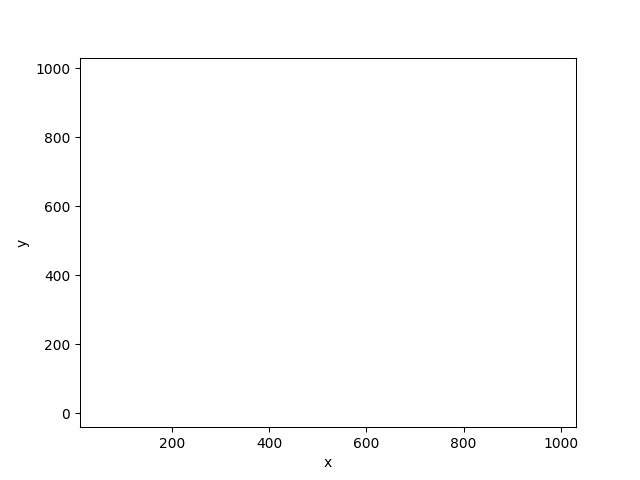

In [266]:
sol,vis=is_intersection_with_visualization(section)
vis.show_gif()

Uzupełnij funkcję ```find_intersections```

In [267]:
def find_intersections(sections):

    def check_duplicates(l1, l2):
        i = lines.index(l1)
        j = lines.index(l2)
        for point in result:
            if (point[1]-1 == i and point[2]-1 == j) or (point[1]-1 == j and point[2]-1 == i):
                return False
        return True
    
    def check_intersect(l1, l2, p):
        intersect_point = intersect(l1, l2)
        if intersect_point is not None  and check_duplicates(l1, l2):
            Q.add(intersect_point)
            result.append(((intersect_point.x,intersect_point.y),intersect_point.s+1,intersect_point.t+1))
    lines, points,upper_bound,lower_bound = get_lines_and_points(sections)
    Q = sc.SortedSet()
    T = sc.SortedSet()
    for point in points:
        Q.add(point)     
    result = []
    Line.update_x(Q[-1].x)
    while len(Q) > 0:
        p = Q.pop()  
        if p.s != p.t:  
            l1 = lines[p.s]
            l2 = lines[p.t]
            T.remove(l1)
            T.remove(l2)
            Line.update_x(p.x+0.000000001)
            T.add(l1)
            T.add(l2)
            i = T.index(l1)
            j = T.index(l2)
            if i > j:
                i, j = j, i
            if i-1 >= 0:
                check_intersect(T[i],T[i-1],p)
            if j+1 < len(T):
                check_intersect(T[j],T[j+1],p)
        elif p == lines[p.s].A:
            Line.update_x(p.x)
            T.add(lines[p.s]) 
            i = T.index(lines[p.s])
            if i-1 >= 0:
                check_intersect(T[i-1], T[i], p)
            if i+1 < len(T):
                check_intersect(T[i+1], T[i], p)
        else:
            l1 = lines[p.s]
            i = T.index(l1)
            if i+1 < len(T) and i-1 >= 0:
                check_intersect(T[i+1], T[i-1], p)
            T.remove(l1)
    print("liczba przecięć:",len(result))
    return result

In [268]:
Test().runtest(3, find_intersections)

Lab 4, task 3:
	Test 1: liczba przecięć: 5
WRONG ANSWER
		Output:   [((-0.0016743790516658141, -0.007263586832941069), 1, 2), ((0.01152607474025421, 0.006132801296422442), 2, 3), ((0.011860591253227503, -0.018140143229495413), 3, 1), ((0.0223444511307787, 0.017111754849194888), 2, 4), ((0.022658670631229855, -0.026817363547212175), 4, 1)]
		Expected: ['-0.0016743790516658117 -0.007263586832941072 1 2', '0.011526074740254208 0.006132801296422439 2 3', '0.011860591253227505 -0.018140143229495424 1 3', '0.022344451130778698 0.01711175484919488 2 4', '0.022658670631229855 -0.026817363547212168 1 4']
	Test 2: liczba przecięć: 3
WRONG ANSWER
		Output:   [((0.005806934807635715, -0.01655644472067816), 2, 3), ((0.013332591183346308, -0.01619339562692305), 3, 4), ((0.010025601838031008, -0.020988202988542266), 2, 4)]
		Expected: ['0.005806934807635715 -0.016556444720678153 2 3', '0.010025601838031018 -0.020988202988542273 2 4', '0.013332591183346312 -0.01619339562692305 3 4']
	Test 3: liczba pr

Uzupełnij funkcję ```find_intersections_with_visualization```

In [269]:
def find_intersections_with_visualisation(sections):
    vis=Visualizer()
    vis.add_line_segment(sections)
    def check_duplicates(l1, l2):
        i = lines.index(l1)
        j = lines.index(l2)
        for point in result:
            if (point[1]-1 == i and point[2]-1 == j) or (point[1]-1 == j and point[2]-1 == i):
                return False
        return True
    
    def check_intersect(l1, l2, p):
        intersect_point = intersect(l1, l2)
        if intersect_point is not None and check_duplicates(l1, l2):
        
            Q.add(intersect_point)
            vis.add_point((intersect_point.x,intersect_point.y),color='red')
            result.append(((intersect_point.x,intersect_point.y),intersect_point.s+1,intersect_point.t+1))
            
    lines, points,upper_bound,lower_bound = get_lines_and_points(sections)
    Q = sc.SortedSet()
    T = sc.SortedSet()
    for point in points:
        Q.add(point)     
    result = []
    Line.update_x(Q[-1].x)
    events=[(p.x,p.y)for p in Q]
    vis.add_point(events,color='green') 
    while len(Q) > 0:
        p = Q.pop()
        sweep=vis.add_line_segment(((p.x,lower_bound),(p.x,upper_bound)),color='red')
        if p.s != p.t:  
            l1 = lines[p.s]
            l2 = lines[p.t]
            T.remove(l1)
            T.remove(l2)
            Line.update_x(p.x+0.000000001)
            T.add(l1)
            T.add(l2)
            i = T.index(l1)
            j = T.index(l2)
            if i > j:
                i, j = j, i
            if i-1 >= 0:
                check_intersect(T[i],T[i-1],p)
            if j+1 < len(T):
                check_intersect(T[j],T[j+1],p)
        elif p == lines[p.s].A:
            Line.update_x(p.x)
            vis.add_line_segment(((lines[p.s].A.x,lines[p.s].A.y),(lines[p.s].B.x,lines[p.s].B.y)),color='purple')
            T.add(lines[p.s]) 
            i = T.index(lines[p.s])
            if i-1 >= 0:
                check_intersect(T[i-1], T[i], p)
            if i+1 < len(T):
                check_intersect(T[i+1], T[i], p)
        else:
            l1 = lines[p.s]
            i = T.index(l1)
            if i+1 < len(T) and i-1 >= 0:
                check_intersect(T[i+1], T[i-1], p)
            T.remove(l1)
            vis.add_line_segment(((lines[p.s].A.x,lines[p.s].A.y),(lines[p.s].B.x,lines[p.s].B.y)),color='black')
        if p.s==p.t: 
            vis.add_point((p.x,p.y),color='black')
        vis.remove_figure(sweep)
        
    return vis

Testowanie algorytmu na różnych zbiorach

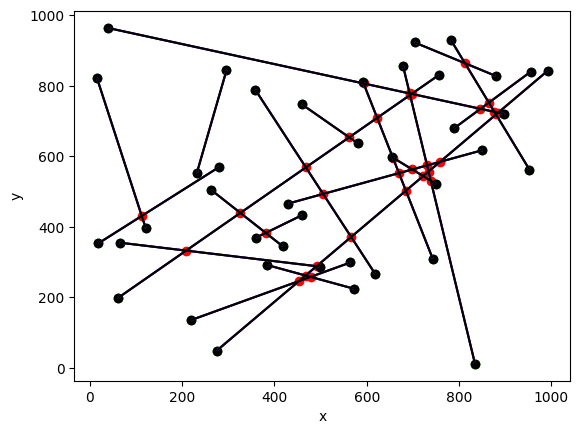

In [299]:
vis=find_intersections_with_visualisation(section)
vis.show()

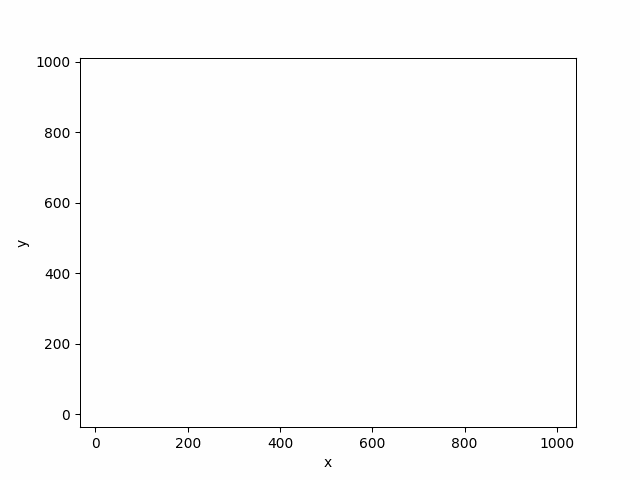

In [300]:
vis.show_gif()

In [272]:
section1=[((-0.034729840063279685, 0.019299425704806472 ),(0.030693547033494514, -0.03327410370695825)),
((-0.02962903361166678, -0.03563317233440923 ),(0.03379838574317193, 0.028735700214610402)),
((0.01117741800123645, 0.031431778645982955 ),(0.012064514775429996 ,-0.032937093903036674)),
((0.02226612767865581, 0.028061680606767267 ),(0.022709676065752582, -0.03394812331480138)),
((-0.024306452966505486 ,-0.015412584099115098 ),(-0.017431452966505487 ,-0.007661358608919019))]

section2=[((-0.04271371103102162 ,0.007908498446146661 ),(0.004302418001236444, -0.03691380547542198)),
((-0.03384274328908614, 0.02509599844614667 ),(0.017165321227042896, -0.02848856037738276)),
((-0.011000001353602261 ,-0.017367236847970993 ),(0.030915321227042908 ,-0.015345178024441575)),
((0.002528224452849351, -0.03185865841659845 ),(0.02670161154962354, 0.0031903611912447033))]

section3=[((0.017165321227042896, 0.04471558346467863 ),(0.03468548251736549 ,-0.0014547596725763001)),
((-0.0019072594181183955, 0.030224161896051163 ),(0.02781048251736548, -0.0065099067313998255)),
((-0.0065645174826345215, 0.002589357974482537 ),(0.027588708323817088, -0.011228043986301783)),
((-0.003903227160053882, -0.0294265733980665 ),(0.028697579291559028, -0.020664318496105713)),
((-0.024306452966505486, -0.0122390733980665 ),(0.002971772839946124, -0.017631230260811592)),
((-0.020536291676182906, 0.0234839658176198 ),(0.002528224452849351, 0.010340583464678615)),
((-0.0327338723213442, -0.02875255379022336 ),(0.0009758050980106375, -0.03818882830002729)),
((-0.04271371103102162, -0.003813828300027272 ),(-0.018096775547150654, -0.00010672045689001652)),
((-0.04559677554715065, 0.036290338366639405 ),(-0.024306452966505486 ,0.011688622680364885)),
((0.02226612767865581 ,-0.03919985771179199 ),(0.044665321227042906, -0.01965328908434101))]
section4=[((0.2016129032258065, 9.312770562770563), (3.3064516129032255, 8.933982683982684)),
((3.9919354838709675, 8.906926406926408), (8.568548387096774, 8.961038961038962)),
((0.24193548387096775, 7.797619047619049), (3.4475806451612905, 7.851731601731602)),
((3.8104838709677415, 7.878787878787879), (8.588709677419354, 7.6893939393939394)),
((0.24193548387096775, 6.796536796536797), (3.0846774193548385, 6.8777056277056285)),
((3.6895161290322585, 6.850649350649352), (8.77016129032258, 6.8777056277056285)),
((0.2620967741935485, 5.930735930735931), (5.02016129032258, 6.038961038961039)),
((5.564516129032258, 6.390692640692642), (8.46774193548387, 5.57900432900433)),
((0.18145161290322576, 5.2813852813852815), (2.7822580645161294, 5.362554112554113)),
((3.9314516129032255, 5.200216450216451), (9.09274193548387, 4.848484848484849)),
((0.38306451612903225, 4.307359307359308), (8.951612903225806, 3.9556277056277063)),
((0.625, 3.387445887445888), (9.133064516129032, 3.116883116883117)),
((0.584677419354839, 2.5216450216450217), (3.8104838709677415, 2.5216450216450217)),
((4.838709677419354, 2.4404761904761907), (8.508064516129032, 2.3322510822510822)),
((0.504032258064516, 1.628787878787879), (3.8306451612903225, 1.7911255411255413)),
((4.798387096774194, 1.8993506493506493), (9.012096774193548, 1.4393939393939394)),
((0.10080645161290325, 0.6818181818181817), (8.366935483870968, 9.799783549783552))
]
section5=[((2.4798387096774195, 9.664502164502165), (9.39516129032258, 5.741341991341992)),
((2.157258064516129, 9.015151515151516), (9.254032258064516, 4.632034632034633)),
((9.71774193548387, 3.5227272727272734), (1.532258064516129, 8.744588744588745)),
((0.866935483870968, 8.528138528138529), (9.657258064516128, 3.0357142857142856)),
((9.41532258064516, 2.2781385281385282), (0.5443548387096775, 8.095238095238097)),
((9.375, 1.70995670995671), (0.12096774193548399, 7.743506493506494)),
((0.4233870967741935, 6.9859307359307365), (9.032258064516128, 1.3582251082251084)),
((8.629032258064516, 1.0876623376623376), (0.524193548387097, 6.147186147186148)),
((0.4838709677419355, 5.416666666666667), (7.52016129032258, 1.0064935064935066)),
((6.955645161290322, 0.5735930735930737), (0.524193548387097, 4.659090909090909)),
((0.443548387096774, 3.9015151515151523), (5.887096774193548, 0.6006493506493507)),
((5.141129032258064, 0.46536796536796543), (0.6451612903225805, 2.792207792207792)),
((0.7661290322580645, 1.8181818181818183), (3.1048387096774195, 9.745670995670997)),
((3.7298387096774195, 9.71861471861472), (1.1693548387096775, 1.682900432900433)),
((1.592741935483871, 1.628787878787879), (4.475806451612904, 9.204545454545455)),
((2.056451612903226, 1.547619047619048), (5.0, 9.015151515151516)),
((2.7822580645161294, 1.277056277056277), (5.362903225806452, 8.663419913419915)),
((3.0846774193548385, 1.141774891774892), (6.370967741935484, 8.33874458874459)),
((3.6088709677419355, 0.8982683982683981), (6.89516129032258, 8.068181818181818)),
((4.09274193548387, 0.7900432900432901), (7.338709677419354, 7.391774891774892)),
((4.657258064516128, 0.4383116883116882), (8.104838709677418, 7.229437229437231))]



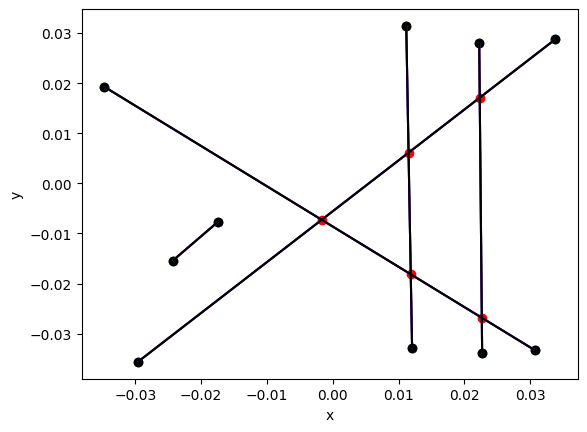

In [273]:
vis1gif=find_intersections_with_visualisation(section1)
vis1gif.show()

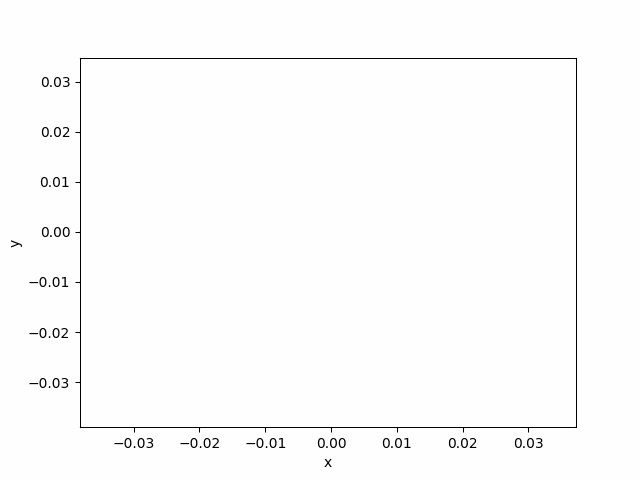

In [274]:
vis1gif.show_gif()

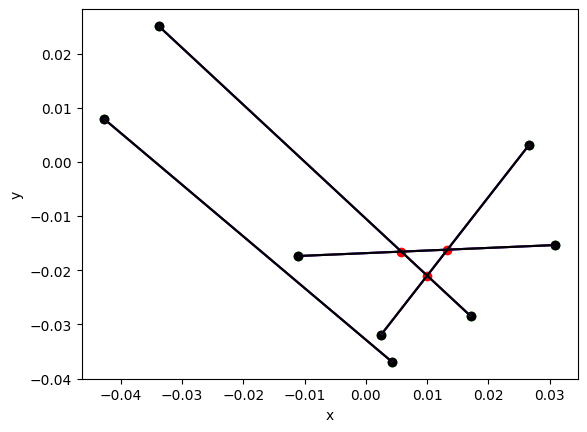

In [275]:
vis2gif=find_intersections_with_visualisation(section2)
vis2gif.show()

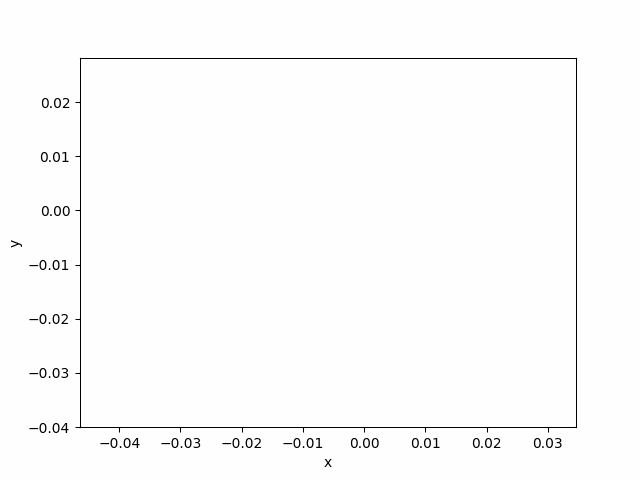

In [276]:
vis2gif.show_gif()

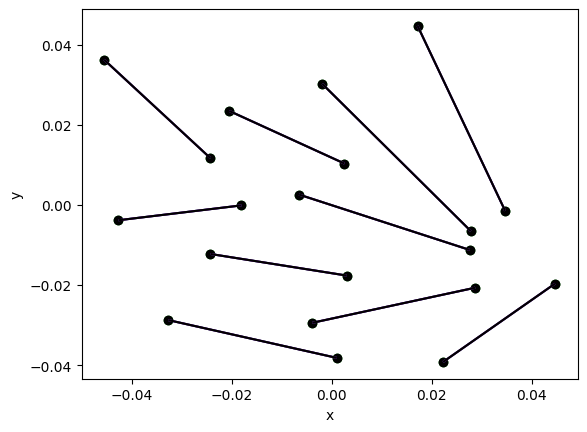

In [277]:
vis3gif=find_intersections_with_visualisation(section3)
vis3gif.show()

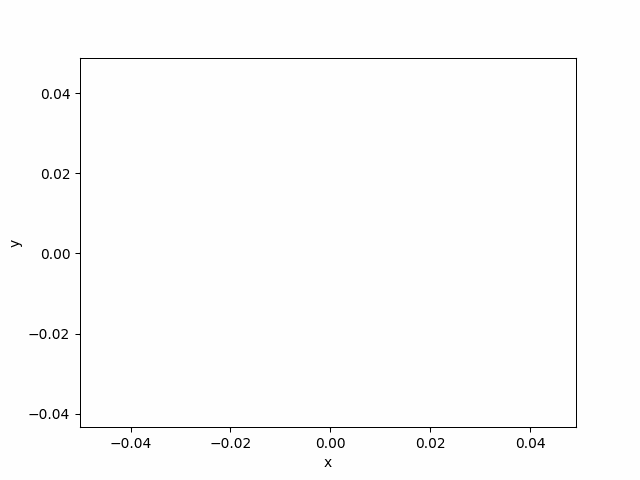

In [278]:
vis3gif.show_gif()

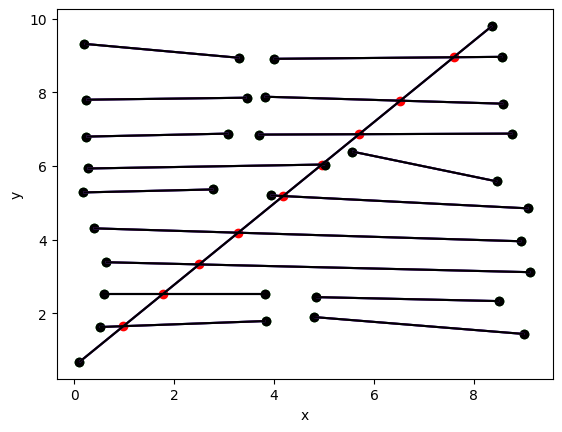

In [279]:
vis4gif=find_intersections_with_visualisation(section4)
vis4gif.show()

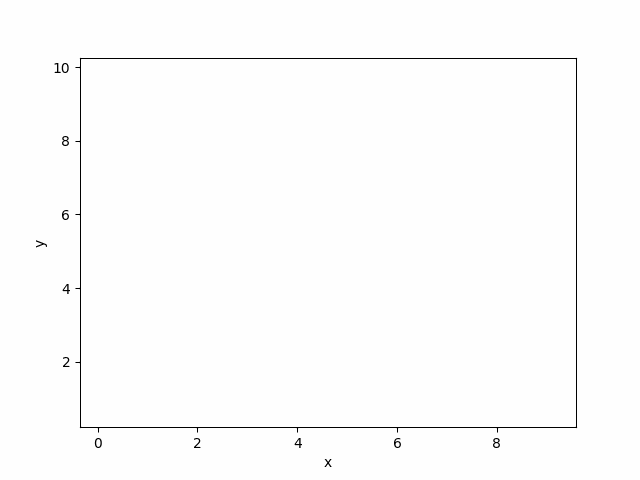

In [280]:
vis4gif.show_gif()

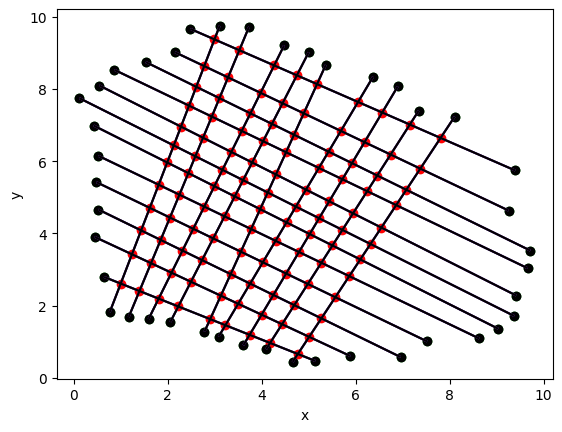

In [281]:
vis5gif=find_intersections_with_visualisation(section5)
vis5gif.show()

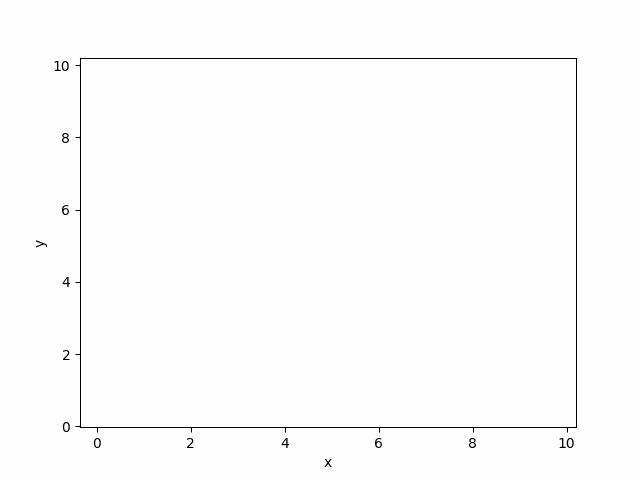

In [282]:
vis5gif.show_gif()